### Import packages 

In [1]:
import tensorflow as tf
from tensorflow.python.client import device_lib
tf.config.list_physical_devices('GPU')

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

In [9]:
from tensorflow import keras
from keras.utils.np_utils import to_categorical
from keras.preprocessing import image
from tensorflow.keras import Input, Model
from keras.layers import *
from keras.metrics import CategoricalAccuracy, MeanAbsoluteError
from plotly.subplots import make_subplots
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import numpy as np
import time
import pandas as pd

### Load Data 

Let's begin by loading the training & validation sets

In [3]:
main = pd.read_csv('output/train.csv')
val = pd.read_csv('output/val.csv')

### Exploratory Data Analysis 

Let's examine the first 9 images of the training set

In [4]:
fig = make_subplots(rows=3, cols=3)
for i in range(9):
    img = image.load_img('output/crop/'+main['filename'][i], target_size=(200, 200))
    x = image.img_to_array(img)
    fig.add_trace(go.Image(z=x), i//3+1, i%3+1)

fig.update_layout(height=600, width=600, title_text="Stacked Images")
fig.show()    

### Modeling 

Due to the large data size, loading the entire training set into the model at once will result in out-of-memory. \
We can mitigate this by using a data generator to feed images & train our model in batches.

In [5]:
from tensorflow.keras.utils import Sequence
class DataGenerator(Sequence):

    def __init__(self, data, image_path, width, height, 
                 to_fit=True, batch_size=128,
                 n_channels=3, shuffle=True):
        self.data = data
        self.list_IDs = list(data.index)
        self.image_path = image_path
        self.to_fit = to_fit
        self.batch_size = batch_size
        self.width = width
        self.height = height
        self.n_channels = n_channels
        self.shuffle = shuffle
        self.on_epoch_end()

    def __len__(self):
        return int(np.floor(len(self.list_IDs) / self.batch_size))

    def __getitem__(self, index):
        # Generate indexes of the batch
        indexes = self.indexes[index * self.batch_size:(index + 1) * self.batch_size]

        # Find list of IDs
        list_IDs_temp = [self.list_IDs[k] for k in indexes]

        # Generate data
        X = self._generate_X(list_IDs_temp)

        y_age, y_gender = self._generate_y(list_IDs_temp)
        return X, [y_age, y_gender]

    def on_epoch_end(self):
        self.indexes = np.arange(len(self.list_IDs))
        if self.shuffle == True:
            np.random.shuffle(self.indexes)

    def _generate_X(self, list_IDs_temp):
        # Initialization
        X = np.zeros((self.batch_size, self.height, self.width, self.n_channels), dtype=float)

        # Generate data
        for i, ID in enumerate(list_IDs_temp):
            # Store sample
            img = image.load_img(self.image_path+self.data['filename'][ID], target_size=(200, 200))
            x = image.img_to_array(img)
            x /= 255
            x = x.astype('float32')
            X[i,] = x

        return X

    def _generate_y(self, list_IDs_temp):
        y_age = np.zeros((self.batch_size), dtype=int)
        y_gender = np.zeros((self.batch_size), dtype=int)
        # Generate data
        for i, ID in enumerate(list_IDs_temp):
            y_age[i] = self.data['age'][ID]
            y_gender[i] = self.data['gender'][ID]
            
        return y_age, to_categorical(y_gender,num_classes=2)


In [6]:
training_generator = DataGenerator(main, 'output/crop/', 200, 200)
validation_generator = DataGenerator(val, 'output/crop/', 200, 200)

In [7]:
input_shape = (200,200,3)
inputs = Input(shape=input_shape)

'''AGE'''
x = Conv2D(16,(3,3),strides=(1,1),padding='same',data_format='channels_last',activation='relu')(inputs)
x = BatchNormalization()(x)
x = MaxPooling2D(pool_size=(2,2))(x)
x = Conv2D(32,(3,3),strides=(1,1),padding='same',data_format='channels_last',activation='relu')(x)
x = BatchNormalization()(x)
x = MaxPooling2D(pool_size=(2,2))(x)
x = Conv2D(64,(3,3),strides=(1,1),padding='same',data_format='channels_last',activation='relu')(x)
x = BatchNormalization()(x)
x = MaxPooling2D(pool_size=(2,2))(x)
x = Conv2D(128,(3,3),strides=(1,1),padding='same',data_format='channels_last',activation='relu')(x)
x = BatchNormalization()(x)
x = Conv2D(128,(3,3),strides=(1,1),padding='same',data_format='channels_last',activation='relu')(x)
x = BatchNormalization()(x)
x = MaxPooling2D(pool_size=(2,2))(x)

x = Flatten()(x)
x = Dense(units=32, activation='relu')(x)
output_age = Dense(units=1, activation='relu',name='cat_age')(x)

'''GENDER'''
y = Conv2D(16,(3,3),strides=(1,1),padding='same',data_format='channels_last',activation='relu')(inputs)
y = BatchNormalization()(y)
y = MaxPooling2D(pool_size=(2,2))(y)
y = Dropout(0.1)(y)
y = Conv2D(32,(3,3),strides=(1,1),padding='same',data_format='channels_last',activation='relu')(y)
y = BatchNormalization()(y)
y = MaxPooling2D(pool_size=(2,2))(y)
y = Dropout(0.1)(y)
y = Conv2D(64,(3,3),strides=(1,1),padding='same',data_format='channels_last',activation='relu')(y)
y = BatchNormalization()(y)
y = MaxPooling2D(pool_size=(2,2))(y)
y = Dropout(0.1)(y)

y = Flatten()(y)
y = Dense(units=32, activation='relu')(y)
output_gender = Dense(units=2, activation='softmax',name='cat_gender')(y)

model = Model(inputs=inputs, outputs=[output_age, output_gender])

model.compile(loss={'cat_age': 'mean_absolute_error', 
                    'cat_gender': 'categorical_crossentropy'},
              optimizer='adam',
              metrics={'cat_gender': CategoricalAccuracy(name='gender_acc')},
              loss_weights = [1,1])

start = time.time()
history = model.fit(training_generator, validation_data=validation_generator, epochs=2)
end = time.time()
print(f"training time: {round((end-start)/60,1)} mins")
model.summary()

Epoch 1/2
2080/2080 [==============================] - 1055s 505ms/step - loss: 10.0076 - cat_age_loss: 9.4459 - cat_gender_loss: 0.5618 - cat_gender_gender_acc: 0.7303 - val_loss: 9.5902 - val_cat_age_loss: 9.0170 - val_cat_gender_loss: 0.5732 - val_cat_gender_gender_acc: 0.6999
Epoch 2/2
2080/2080 [==============================] - 1108s 533ms/step - loss: 9.0030 - cat_age_loss: 8.4896 - cat_gender_loss: 0.5134 - cat_gender_gender_acc: 0.7629 - val_loss: 9.0966 - val_cat_age_loss: 8.5855 - val_cat_gender_loss: 0.5112 - val_cat_gender_gender_acc: 0.7655
training time: 36.1 mins
Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 200, 200, 3) 0                                            
__________________________________________________________________________________________________
con

The model gives a decent performance on the vaslidation set with mae of 8.5855 for age & categorical crossentropy of 0.5112 for gender

### Sample Prediction 

Let's load 1 image & see what our model predicts 

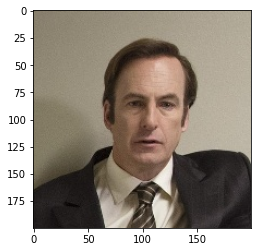

In [22]:
img = image.load_img('output/crop/'+main['filename'][100], target_size=(200, 200))
x = image.img_to_array(img)
plt.imshow(x/255)

In [23]:
X = np.zeros((1, 200, 200, 3), dtype=float)
x /= 255
x = x.astype('float32')
X[0,] = x
res = model.predict(X)

For this image, model predict male & age of 53.3. \
Not far from actual ground truths.

In [35]:
print(f"model prediction: {np.argmax(res[1]), res[0][0][0]}")
print(f"image ground truth: {main['gender'][100], main['age'][100]}")

model prediction: (1, 53.253414)
image ground truth: (1, 52)
